### Laboratorium 4 - zadania

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries, slic
from skimage.util import img_as_float

#### Zadanie 1

Dane są obrazy `tabby` i `pills`. Wykonaj dla nich segmentację przy użyciu algorytmu SLIC. Celem jest uzyskanie **jednolitych**  superpikseli, a więc zawierających tylko fragmenty obiektów lub tylko tła (a nie jednego i drugiego naraz). Przeanalizuj zachowanie algorytmu dla różnej liczby superpikseli i parametru sigma.

Zwróć uwagę, że wynikiem działania scikitowej implementacji SLIC - [`skimage.segmentation.slic`](https://scikit-image.org/docs/stable/api/skimage.segmentation.html#skimage.segmentation.slic) - (podobnie jak wielu innych algorytmów klasyfikacyjnych) jest obraz typu `np.int64` przyporządkowujący każdemu pikselowi obrazu wejściowego indeks superpiksela. Takiej reprezentacji oczekuje też funkcja [`mark_boundaries`](https://scikit-image.org/docs/stable/api/skimage.segmentation.html#skimage.segmentation.mark_boundaries).

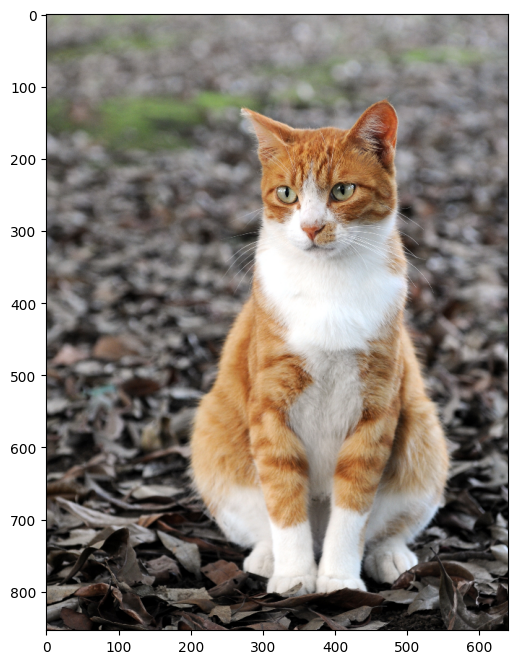

In [4]:
_ = cv2.imread('tabby.jpg')[..., ::-1]
tabby = cv2.resize(_, dsize=None, fx=0.3, fy=0.3)
plt.subplots(1,1,figsize=(8,8))[1].imshow(tabby);

In [5]:
def plot_rgb_histogram(image):
    colors = ('r', 'g', 'b')
    channel_names = ('Red', 'Green', 'Blue')
    plt.figure(figsize=(10, 6))
    plt.title('Histogram rozkładu kanałów RGB', color='black')
    plt.xlabel('Intensywność pikseli')
    plt.ylabel('Liczba pikseli')

    for i, color in enumerate(colors):
        hist = cv2.calcHist([image], [i], None, [256], [0, 256])
        plt.plot(hist, color=color, label=channel_names[i])

    plt.xlim([0, 256])
    plt.legend(loc='upper right')
    plt.show()

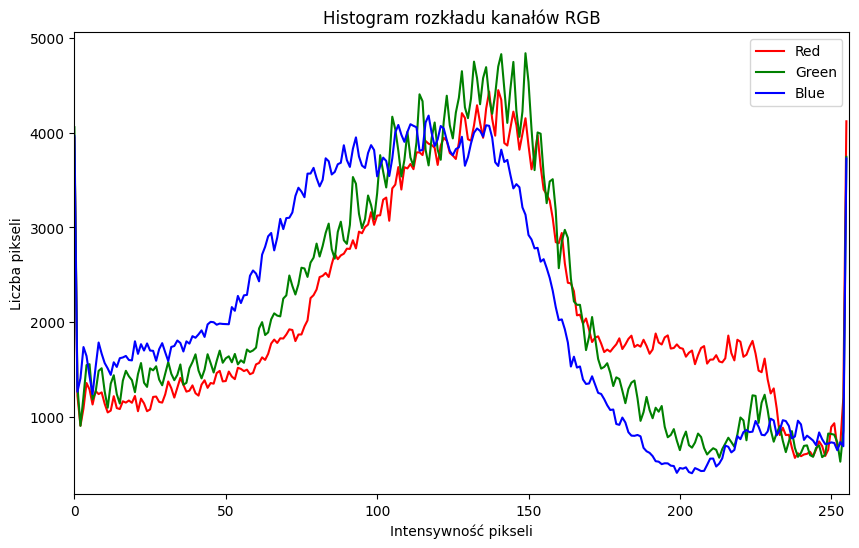

In [6]:
plot_rgb_histogram(tabby)

In [7]:
def slic_segmentation_plot(image, n_segments_list, sigma_list, fig_size):
    fig, axs = plt.subplots(len(n_segments_list), len(sigma_list), figsize=fig_size, facecolor='black')
    fig.suptitle('Segmentacja SLIC dla różnych wartości n_segments i sigma', color='white', fontsize=16)
    
    for row, n_segments in enumerate(n_segments_list):
        for col, sigma in enumerate(sigma_list):
            # Segmentacja przy użyciu SLIC
            segments_slic = slic(image, n_segments=n_segments, sigma=sigma, start_label=1)
            # Rysowanie wyników z zaznaczonymi granicami superpikseli
            axs[row, col].imshow(mark_boundaries(image, segments_slic))
            axs[row, col].set_title(f'Segmenty: {n_segments}, sigma: {sigma}', color='white')
            axs[row, col].axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    plt.show()

def slic_segmentation_plot_compactness(image, n_segments_list, compactness_list, fig_size):
    fig, axs = plt.subplots(len(n_segments_list), len(compactness_list), figsize=fig_size, facecolor='black')
    fig.suptitle('Segmentacja SLIC dla różnych wartości n_segments i compactness', color='white', fontsize=16)
    
    for row, n_segments in enumerate(n_segments_list):
        for col, compactness in enumerate(compactness_list):
            segments_slic = slic(image, n_segments=n_segments, compactness=compactness, sigma=2, start_label=1)
            axs[row, col].imshow(mark_boundaries(image, segments_slic))
            axs[row, col].set_title(f'Seg: {n_segments}, C: {compactness}', color='white')
            axs[row, col].axis('off')

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    plt.show()

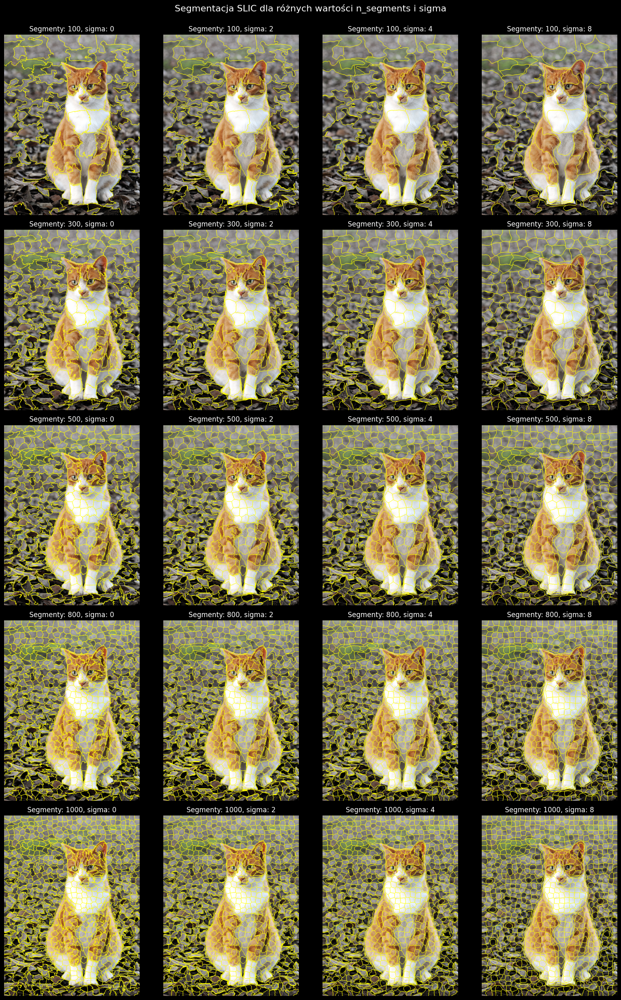

In [8]:
tabby_n_segments_list = [100, 300, 500, 800, 1000]
tabby_sigma_list = [0, 2, 4, 8]
slic_segmentation_plot(tabby, tabby_n_segments_list, tabby_sigma_list, (16, 25))

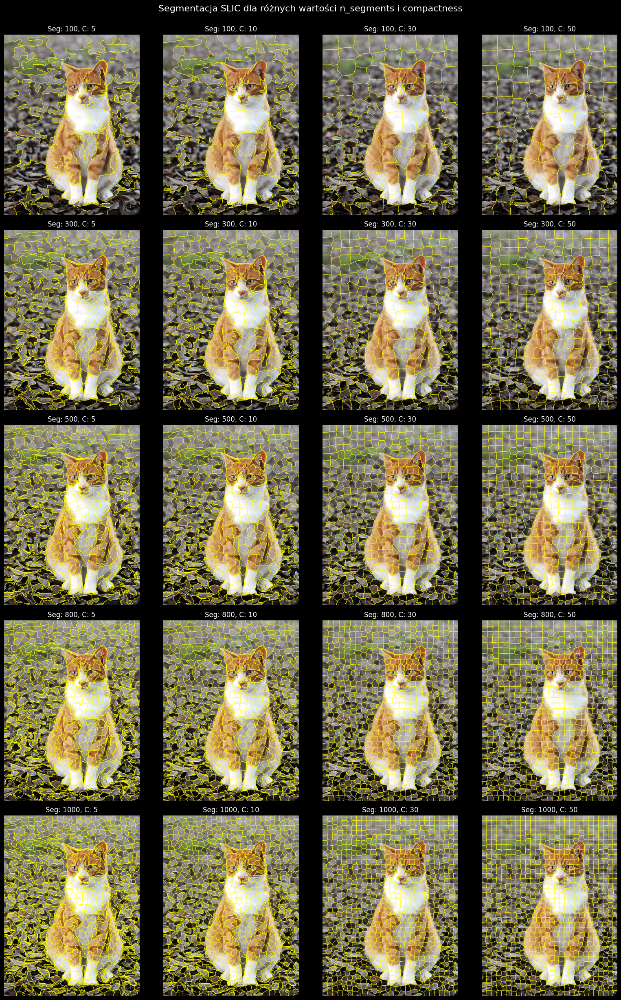

In [9]:
tabby_n_segments_list = [100, 300, 500, 800, 1000]
tabby_compactness_list = [5, 10, 30, 50]
slic_segmentation_plot_compactness(tabby, tabby_n_segments_list, tabby_compactness_list, (16, 25))

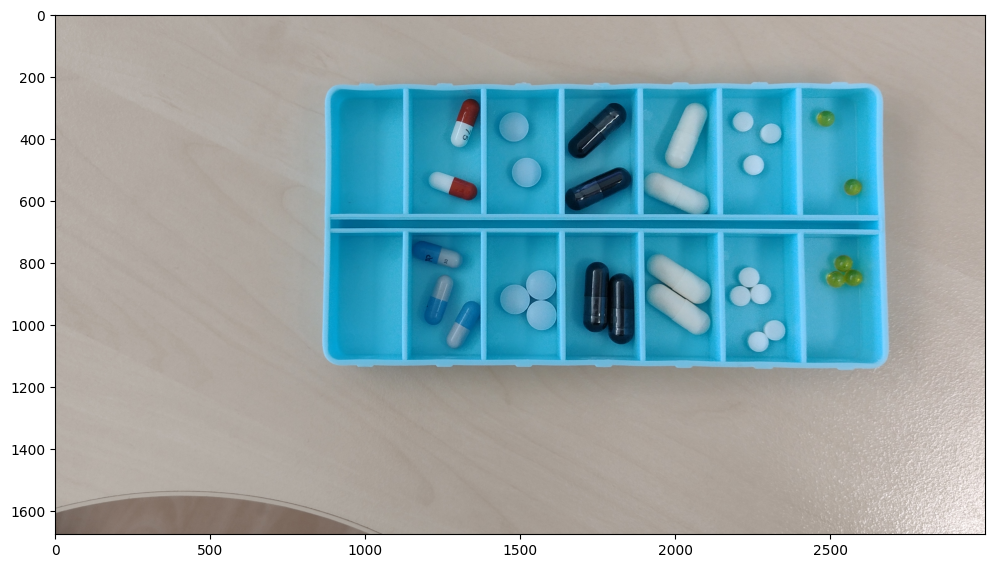

In [10]:
pills = cv2.imread('pills.png')[..., ::-1]
plt.subplots(1,1,figsize=(12,8))[1].imshow(pills);

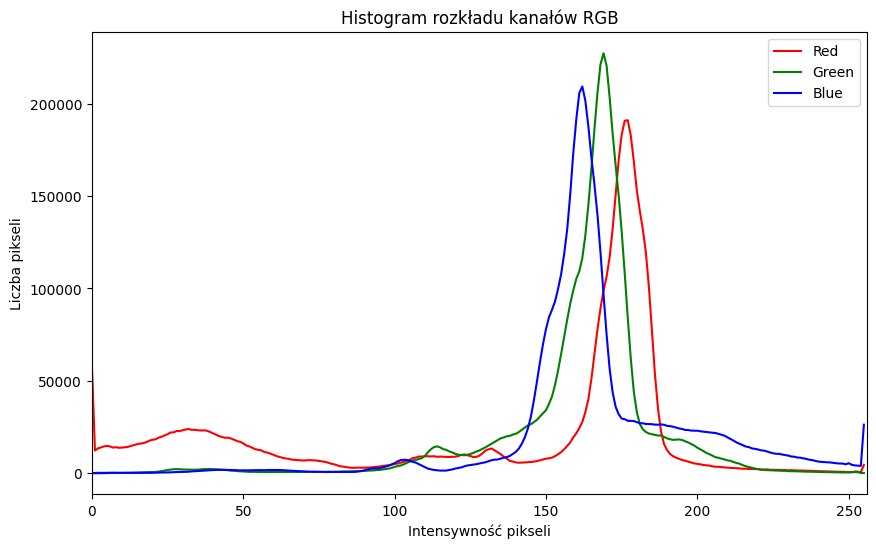

In [11]:
plot_rgb_histogram(pills)

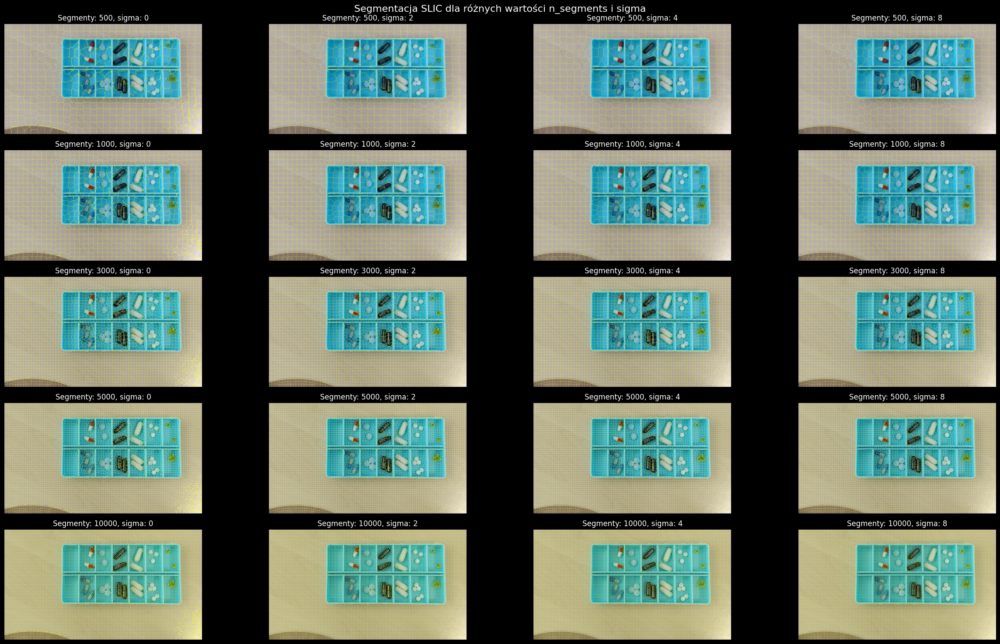

In [12]:
pills_n_segments_list = [500, 1000, 3000, 5000, 10000]
pills_sigma_list = [0, 2, 4, 8]
slic_segmentation_plot(pills, pills_n_segments_list, pills_sigma_list, (25, 15))

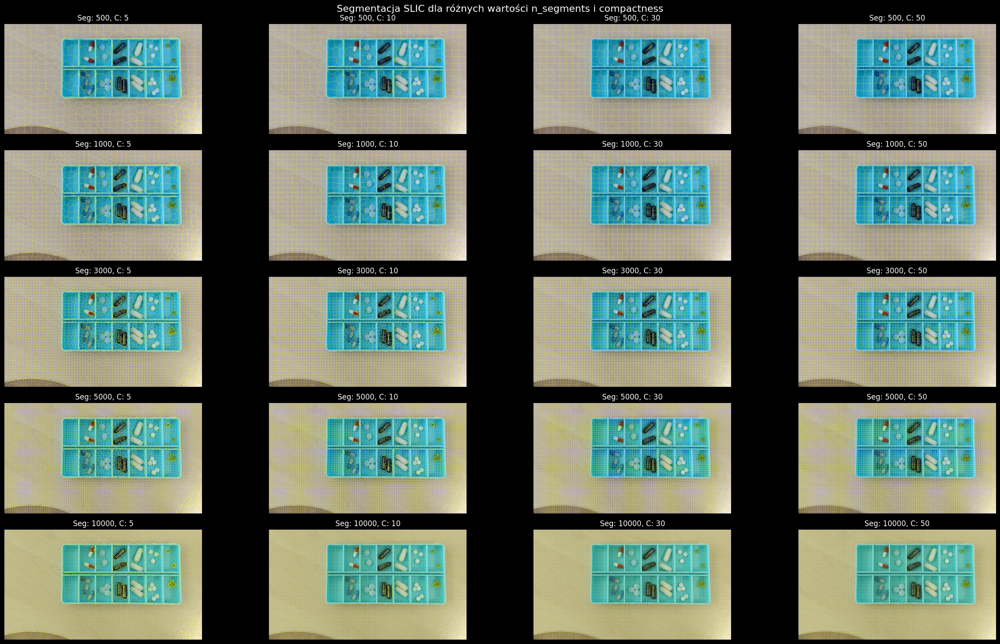

In [13]:
pills_n_segments_list = [500, 1000, 3000, 5000, 10000]
pills_compactness_list = [5, 10, 30, 50]
slic_segmentation_plot_compactness(pills, pills_n_segments_list, pills_compactness_list, (25, 15))

#### Zadanie 2

Dla obrazu `tabby` wykonaj post-processing segmentacji SLIC by uzyskać dwa jednorodne obszary: jeden zawierający wyłącznie kota, drugi zawierający wyłącznie tło.

Można to zadanie potraktować jako binaryzację na poziomie superpikseli i zrealizować je za pomocą progowania. 
Można też potraktować je jako klasteryzację superpikseli i wykorzystać np. [`cv2.kmeans`](https://docs.opencv.org/4.x/d5/d38/group__core__cluster.html#ga9a34dc06c6ec9460e90860f15bcd2f88).  
Niezależnie od wybranej ścieżki, konieczne będzie opisanie każdego z superpikseli za pomocą jakiejś *cechy* go opisującej (lub kilku cech). Najprostszymi cechami mogą być np. średnie wartości składowych barwy pikseli wchodzących w skład superpiksela.  
Do zastanowienia: jakie parametry SLICa wybrać jako podstawę w tym zadaniu?

Zaprezentuj wyniki albo za pomocą `mark_boundaries` albo wyświetlając maskę binarną.

---

NumPy pro-tip: aby uzyskać zbiór wszystkich pikseli obrazu o wartości np. 3 możesz użyć notacji: ```obraz==3```. Wynikiem jest macierz boolowska, której można używać jako selektor. Np. aby na obrazie `A` wyzerować wszystkie piksele, którym w obrazie `B` odpowiada wartość 5, możesz napisać:  
```A[B==5] = 0```  
Ten zapis jest **znacznie** szybszy niż manualne iterowanie po obrazach i sprawdzanie warunków if-ami.

---

Przykładowe użycie `cv2.kmeans` (więcej możesz poczytać np. [tutaj](https://opencv24-python-tutorials.readthedocs.io/en/latest/py_tutorials/py_ml/py_kmeans/py_kmeans_opencv/py_kmeans_opencv.html)):
```python
c, labels, centers = cv2.kmeans(
    data=data,  # np.ndarray typu float o wymiarach NxK gdzie N to liczba sampli (u nas: superpikseli), K - liczba cech
    K=2,        # oczekiwana liczba klastrów
    bestLabels=None,
    criteria=(cv2.TERM_CRITERIA_EPS, 10, 1.0),  # przykładowe kryteria stopu
    attempts=1, # liczba powtórzeń algorytmu
    flags=cv2.KMEANS_RANDOM_CENTERS  # sposób inicjalizacji klastrów
)
```

Funkcja ta zwraca krotkę, której najważniejszym komponentem jest ten drugi (tu: `labels`), tj. macierz o wymiarach Nx1, zawierająca indeks klastra przypisanego i-temu samplowi.

In [14]:
# zacznij od przygotowania macierzy wejściowej (data) reprezentującej superpiksele jako punkty danych

In [20]:
def extract_hsv_features(image, segments):
    """
    Extracts the mean HSV values for each superpixel.
    Returns a feature matrix where each row represents a superpixel.
    """
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    superpixel_ids = np.unique(segments)
    features = []

    for superpixel_id in superpixel_ids:
      mask = segments == superpixel_id
      mean_hsv = np.mean(hsv_image[mask], axis=0)  # mean HSV values for the superpixel
      features.append(mean_hsv)

    return np.array(features), superpixel_ids

In [74]:
n_segments = 300
sigma = 2
compactness = 10
segments = slic(tabby, n_segments=n_segments, sigma=sigma, compactness=compactness)
segmented_image = mark_boundaries(tabby, segments)

features, superpixel_ids = extract_hsv_features(tabby, segments)

criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0)
_, labels, _ = cv2.kmeans(data = features.astype(np.float32), # np.ndarray typu float o wymiarach NxK gdzie N to liczba sampli (u nas: superpikseli), K - liczba cech
                        K = 2, # oczekiwana liczba klastrów
                        bestLabels = None,
                        criteria = criteria, # przykładowe kryteria stopu
                        attempts = 10, # liczba powtórzeń algorytmu
                        flags = cv2.KMEANS_RANDOM_CENTERS) # sposób inicjalizacji klastrów

In [75]:
# Create a binary mask using the HSV-based clustering
binary_mask = np.zeros(segments.shape, dtype=np.uint8)
for i, superpixel_id in enumerate(superpixel_ids):
  binary_mask[segments == superpixel_id] = labels[i]

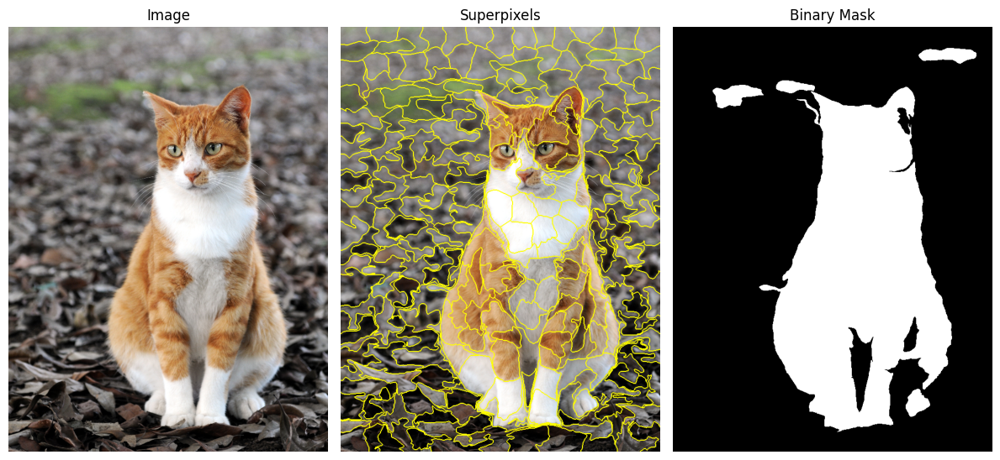

In [76]:
fig, axes = plt.subplots(1, 3, figsize=(12, 6))

axes[0].imshow(tabby)
axes[0].set_title('Image')
axes[0].axis('off')

axes[1].imshow(segmented_image)
axes[1].set_title('Superpixels')
axes[1].axis('off')

axes[2].imshow(binary_mask, cmap='gray')
axes[2].set_title('Binary Mask')
axes[2].axis('off')

plt.tight_layout()
plt.show()

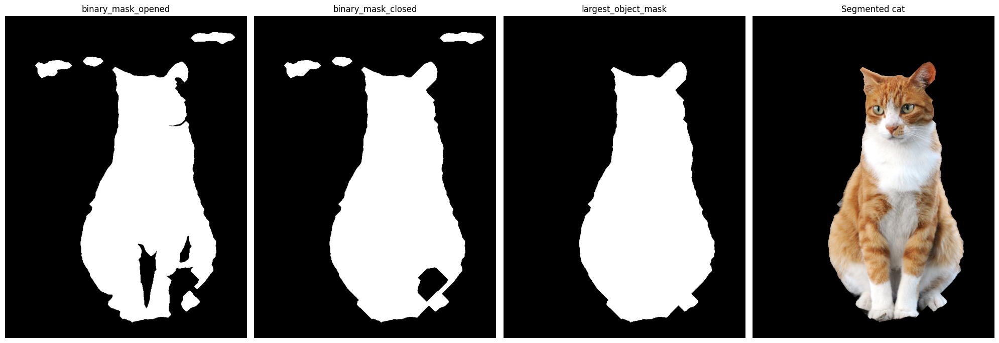

In [ ]:
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3, 3))

# Operacja otwarcia: usunięcie małych zakłóceń
binary_mask_opened = cv2.morphologyEx(binary_mask, cv2.MORPH_OPEN, kernel, iterations=7)

# Operacja zamknięcia: wypełnienie luk wewnątrz obszarów
binary_mask_closed = cv2.morphologyEx(binary_mask_opened, cv2.MORPH_CLOSE, kernel, iterations=23)

contours, _ = cv2.findContours(binary_mask_closed, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
# można usuwać wypukłość jakoś 
largest_contour = max(contours, key=cv2.contourArea)
largest_object_mask = np.zeros_like(binary_mask_closed)
cv2.drawContours(largest_object_mask, [largest_contour], -1, (255), thickness=cv2.FILLED)


fig, axes = plt.subplots(1, 4, figsize=(20, 15))

axes[0].imshow(binary_mask_opened, cmap='gray')
axes[0].set_title('binary_mask_opened')
axes[0].axis('off')

axes[1].imshow(binary_mask_closed, cmap='gray')
axes[1].set_title('binary_mask_closed')
axes[1].axis('off')

axes[2].imshow(largest_object_mask, cmap='gray')
axes[2].set_title('largest_object_mask')
axes[2].axis('off')

axes[3].imshow(cv2.bitwise_and(tabby, tabby, mask=largest_object_mask))
axes[3].set_title('Segmented cat')
axes[3].axis('off')

plt.tight_layout()
plt.show()
